# Assignment 4

In [3]:
library(tidyverse)
library(dplyr)
library(emdbook) #for ncredint
#library(GoFKernel) #for inverse function
library(rgl) #to plot 3D

── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.1     ✔ readr     2.1.4
✔ forcats   1.0.0     ✔ stringr   1.5.0
✔ ggplot2   3.4.1     ✔ tibble    3.2.1
✔ lubridate 1.9.2     ✔ tidyr     1.3.0
✔ purrr     1.0.1     
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors
This build of rgl does not include OpenGL functions.  Use
 rglwidget() to display results, e.g. via options(rgl.printRglwidget = TRUE).



### Exeercise 1
- the number of claims recived by an insurance company during a week follows a Possion distribution with unknown mean($\mu$)\
- the number of claims, per, week, observed over a ten week period are:\
5, 8, 4, 6, 11, 6, 6, 5, 6, 4\
a) suppose to use a prior uniform distribution for $\mu$
- find the posterior distribution for $\mu$ and compute the posterior mean, median and variance\
- plot the posterior distribution and the 95% credibility interval\
b) suppose to use a Jeffery's prior for $\mu(g(\mu))$
- find the posterior distribution for $\mu$ and compute the posterior mean, median and variance\
- plot the posterior distribution and the 95% credibility interval\
c) evaluate a 95% credibility interval for the result obtained with both priors. Compare the result with that obtained using a normal approximation for the posterior distribution, with the same mean and standard deviation.

mean = 6.2 
 variance= 0.62 
 median= 6.166699

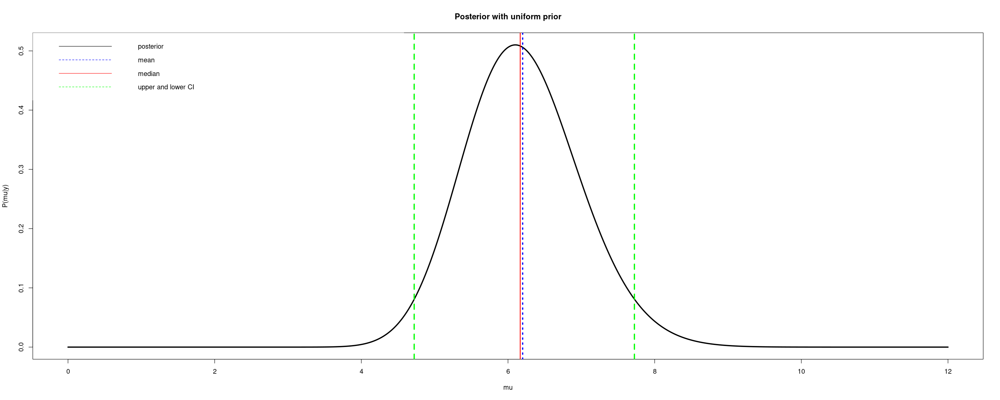

In [29]:
y = c(5, 8, 4, 6, 11, 6, 6, 5, 6, 4)
x <- seq(0,12, length.out=1000)

alpha <- sum(y) +1
lam <- length(y)


mean.uni <- alpha/lam
median.uni <- qgamma(0.5,shape=alpha, rate=lam)
var.uni <- alpha/(lam^2)
post.uni <- dgamma(x=x, shape=alpha, rate=lam)  #posterior

#finding the 95% credibility interval
ci.uni <- ncredint(x, post.uni,level=0.95 )

#print the results
cat("mean =", mean.uni, '\n', 'variance=', var.uni, '\n', 'median=', median.uni)
options(repr.plot.width=25, repr.plot.height=10)

plot(x, post.uni, type='l', lty=1, lwd=3, xlab="mu", ylab='P(mu|y)', main=("Posterior with uniform prior" ))

    abline(v=median.uni, col="red" ,lty=1, lwd=2)
    abline(v= ci.uni[['lower']], col="green" ,lty=2, lwd=3)
    abline(v= ci.uni[['upper']], col="green" ,lty=2, lwd=3)
    abline(v=mean.uni, col='blue', lty=3, lwd=3)
    legend('topleft', legend=c('posterior','mean', 'median', 'upper and lower CI'), col=c('black','blue', 'red', 'green'), lty=1:2, box.lty=0)

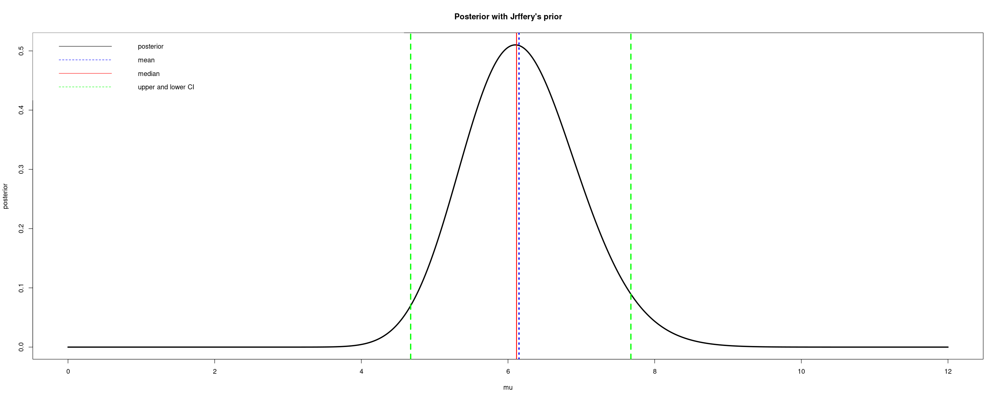

In [28]:
alpha <- sum(y) + 0.5
lam <- length(y)
#like previous cell we will find values but in jeffery prior
mean.jef <- alpha/lam
median.jef <- qgamma(0.5, shape=alpha, rate=lam)
var.jef <- alpha/(lam^2)
post.jef <- dgamma(x=x, shape=alpha, rate=lam)

#credebility interval
ci.jef <- ncredint(x, post.jef,level=0.95)

plot(x, post.uni, type='l', lty=1, lwd=3, xlab="mu", ylab="P(mu|y)", main=("Posterior with Jrffery's prior" ))

    abline(v=median.jef, col="red" ,lty=1, lwd=2)
    abline(v= ci.jef[['lower']], col="green" ,lty=2, lwd=3)
    abline(v= ci.jef[['upper']], col="green" ,lty=2, lwd=3)
    abline(v=mean.jef, col='blue', lty=3, lwd=3)
    legend('topleft', legend=c('posterior','mean', 'median', 'upper and lower CI'), col=c('black','blue', 'red', 'green'), lty=1:2, box.lty=0)

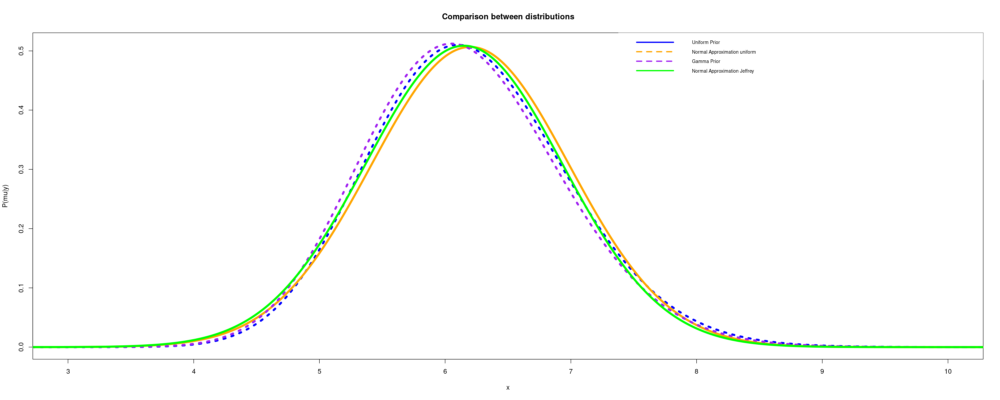

In [52]:
gauss.uni <- dnorm(x = x, mean = mean.uni, sd = sqrt(var.uni))
gauss.jef <- dnorm(x = x, mean = mean.jef, sd = sqrt(var.jef))


plot(x, post.uni, type = 'l',lty=3 , lwd = 5, col = 'blue', xlab = 'x', ylab = 'P(mu|y)', xlim = c(3, 10), main = 'Comparison between distributions')
points(x, gauss.uni, type = 'l', lwd = 5, col = 'orange')
points(x, post.jef, type = 'l',lty=3, lwd = 5, col = 'purple')
points(x, gauss.jef, type = 'l', lwd = 5, col = 'green')

legend(x = 'topright', legend=c("Uniform Prior", "Normal Approximation uniform", "Gamma Prior", "Normal Approximation Jeffrey"),
       lty = c(1, 2, 2, 1), col=c("blue", "orange", "purple", "green"), lwd=3 , box.lty=0,cex = 0.7)


### Exercise 2 that actually have disease.
- a well established and diffused method for detecting a disease in blood fails to detect the presence of disease in 15% of the patients that actually have the disease.
- Ayoung UniPDsturtUp has developed an innovation method of screening. During the qualification phase, a random sample of n=75 patients known to have the disease is screened using the new method. 

##### a) what is the probability distribution of y, the number of times the new method fails to detect the disease ? 
'y' follows the "Binomial Distribution" because it is a success or failure problem(binary problem) that has a fixed probability of success

##### b)on the n = 75 patients sample, the new method fails to detect the disease in y = 6 cases. What is the frequentist estimator of the failure probability of the new method ?
 The frequentist method only uses the newly aquired data. Thus the new failure probability is $\frac{6}{75} =\frac{8}{100}$

##### c) setup a bayesian computation of the posterior probability, assuming a beta distribution with mean value 0.15 and standard deviation 0.14.  Plot the posterior distribution for y, and mark on the plot the mean value and variance 

The mean value is: 0.08478674 
 The standatd deviation is: 0.03085551 
 The variance is: 0.0009520625

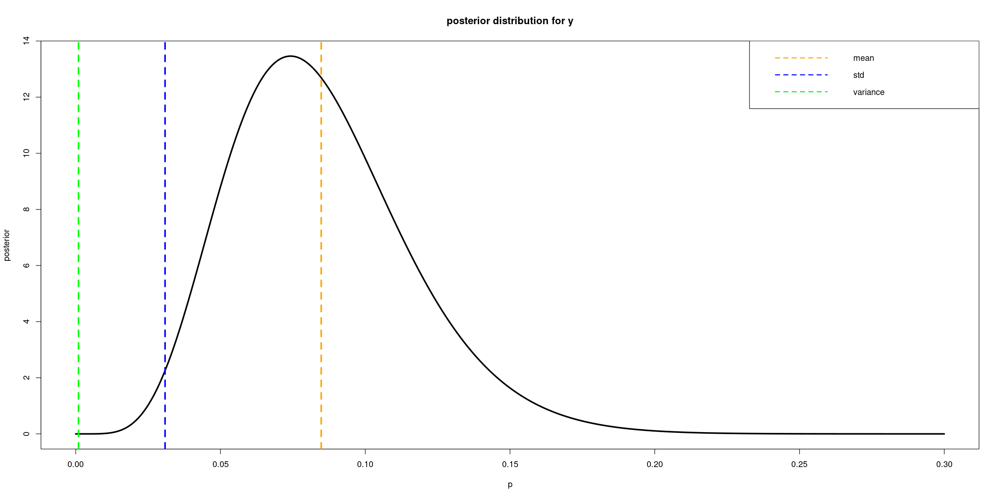

In [54]:
#set.seed(6666)
n <- 75
y <- 6
mean <- 0.15
std <- 0.14
var <- 0.14^2
p <- seq(from=0, to=0.3, length.out=1000)

#prior parameters

a.prior <- mean*(mean*(1-mean)/var-1)
b.prior <- (1-mean)*((mean*(1-mean)/var)-1)
prior <- dbeta(p,a.prior,b.prior)

#since the likelihood is binomial and prior is beta ---> posterior is beta

#posterior parameters
a.post <- a.prior +y
b.post <- b.prior +n -y
post <- dbeta(p,a.post,b.post)
mean.post <- a.post/(a.post+b.post)
std.post <- sqrt((a.post*b.post)/(((a.post+b.post)^2)*(a.post+b.post +1)))
var.post <- (std.post)^2

cat("The mean value is:", mean.post ,
    '\n', "The standatd deviation is:", std.post,
    '\n', "The variance is:", var.post)


options(repr.plot.width=20, repr.plot.height=10)
plot(p, post, type='l', lty=1, lwd=3, xlab="p", ylab="posterior", ylim=c(0, max(post)), main="posterior distribution for y")
abline(v=mean.post, col="orange" ,lty=2, lwd=3)
abline(v=std.post, col="blue" ,lty=2, lwd=3)
abline(v=std.post^2, col="green" ,lty=2, lwd=3)
legend('topright', legend=c('mean', 'std', 'variance'), col=c('orange', 'blue', 'green'), lty=c(2,2,2), lwd=2)


##### d) Perform a test of hypothesis assuming that if the probability of failing to the detect the desease in ill patients is greater or equal than 15%, the new test is no better that the traditional method. Test the sample at a 5% level of significance in the Bayesian way.


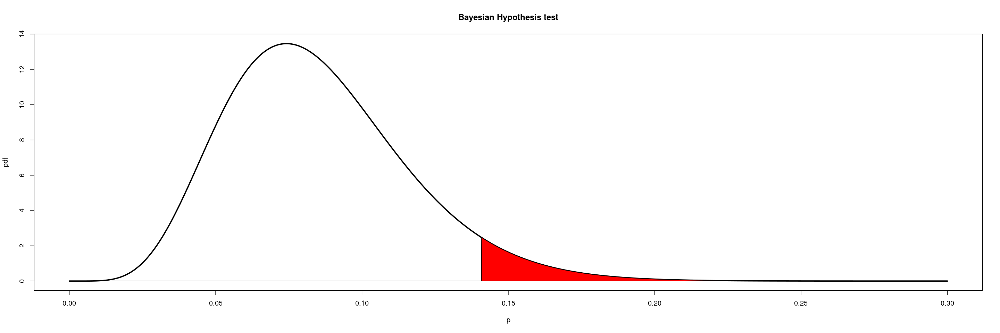

In [32]:
bayes <- qbeta(0.95 , a.post , b.post)
p.bayes <- pbeta(0.15 , a.post, b.post, lower.tail=FALSE)
p.freq <- pbinom(y, size=n, prob=0.15)
cut.freq <- qbinom(0.05, size=n , prob=0.15)

pp <- seq(0,0.3, length.out=1000)
post.bayes <- dbeta(pp , a.post , b.post) 


#these two line is for polygon plotting
df_prob1 <- data.frame(x=pp, post =post)
shade <- rbind(c(bayes,0), subset(df_prob1, x > bayes), c(df_prob1[nrow(df_prob1), "X"], 0))


plot(pp, post,type='l', lty=1, lwd=3, xlab="p", ylab="pdf", ylim=c(0, max(post)), main="Bayesian Hypothesis test")

    polygon(x= shade[,1], y=shade[,2], col ='red')


options(repr.plot.width = 24, repr.plot.height = 8)

##### e) Perform the same hypothesis test in the classical frequentist way.  

In [38]:
trails <- seq(0,n, len=n+1)
cdf <- pbinom(6, size=75, prob=0.15)

if (cdf> 0.05) {

cat("p-value for frequenties approach is:", cdf, '\n')
cat("in the frequenties we accept null hypothesis because foand p-value greater than 0.05")

}

p-value for frequenties approach is: 0.0543533 
in the frequenties we accept null hypothesis because foand p-value greater than 0.05

### Exersice 3
given the problem of the lighthouse discussed last week, study the case in which both the position along the shore ($\alpha$) and the distace out at sea ($\beta$) are unknown

In [55]:
set.seed(205) #it gives us better results

n.data <- c(1,2,3,4,5,10,25,50,100, 1000) #list of samples
N <- 1000

alpha.true <- 3
beta.true <- 50 

generate <- function(N, alpha, beta){
    theta <- runif(N, -pi/2 , pi/2)
    x <- alpha+beta*tan(theta)
    return(x)
}


# Generate dataset
x <- generate(N,alpha.true,beta.true)


#posterior
log.post <- function(data, alpha, beta){
    logl <- 0.0
    for(i in data){
    logl <- logl + log(beta/(pi*(beta^2 + (i-alpha)^2)))
    }
    return(logl)
}

sample <- 200
x.min <- -6
x.max <- +6
h.x <- (x.max-x.min)/sample
alpha.seq <- seq(from=x.min, by=h.x, length.out=sample+1)


y.max <- 100
h.y <- y.max/sample
beta.seq <- seq(from=0, by=h.y, length.out=sample+1)


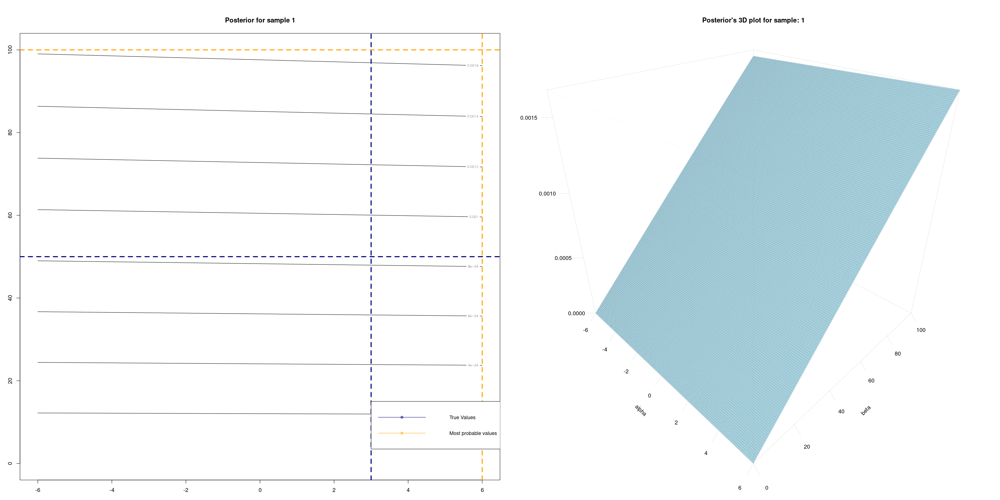

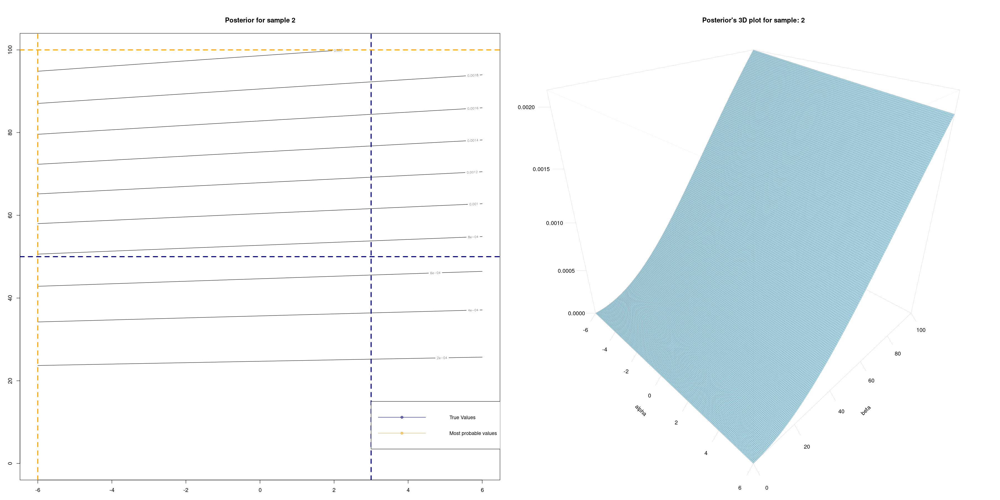

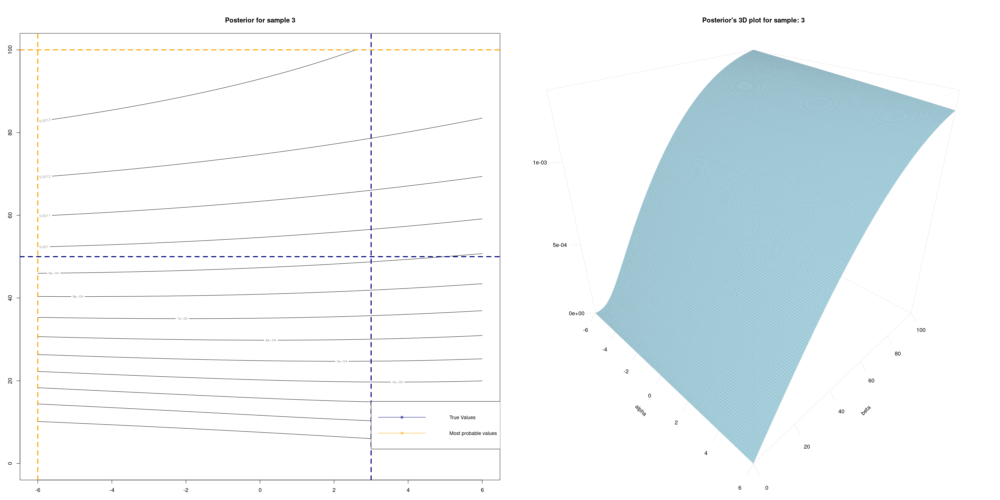

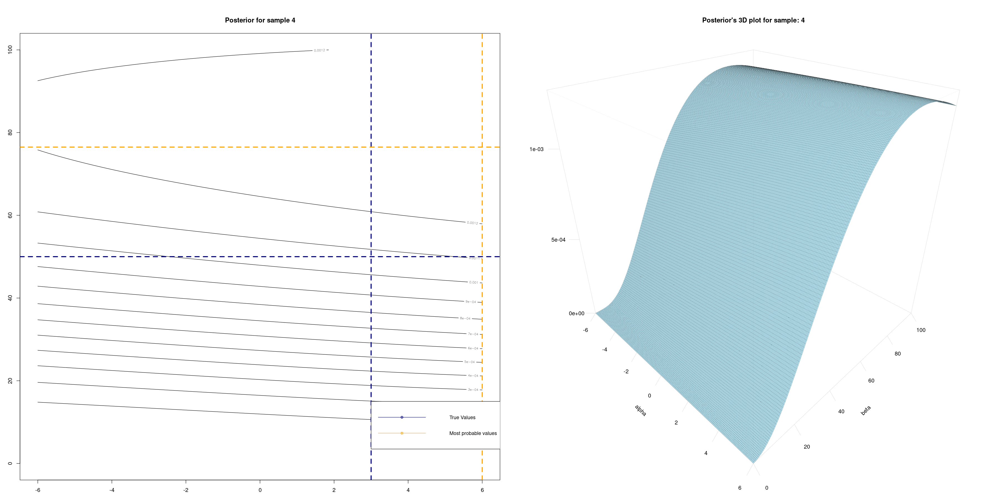

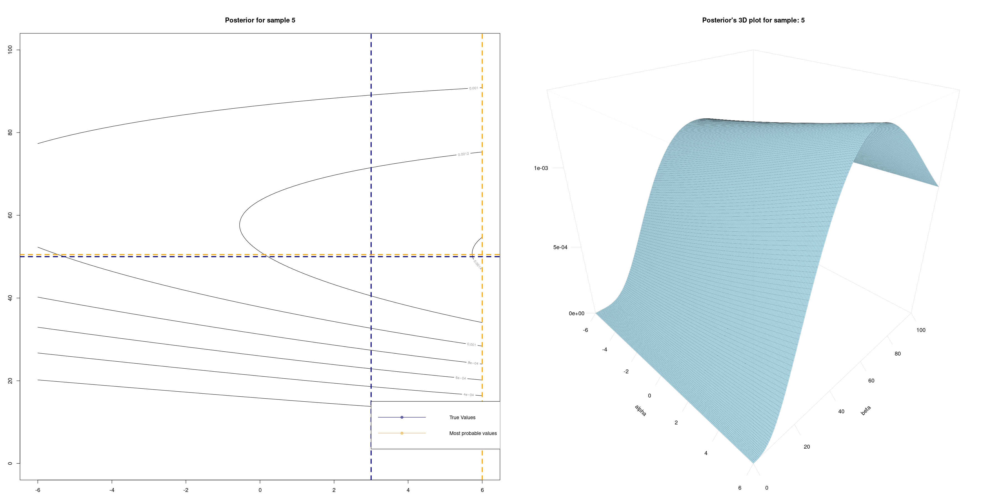

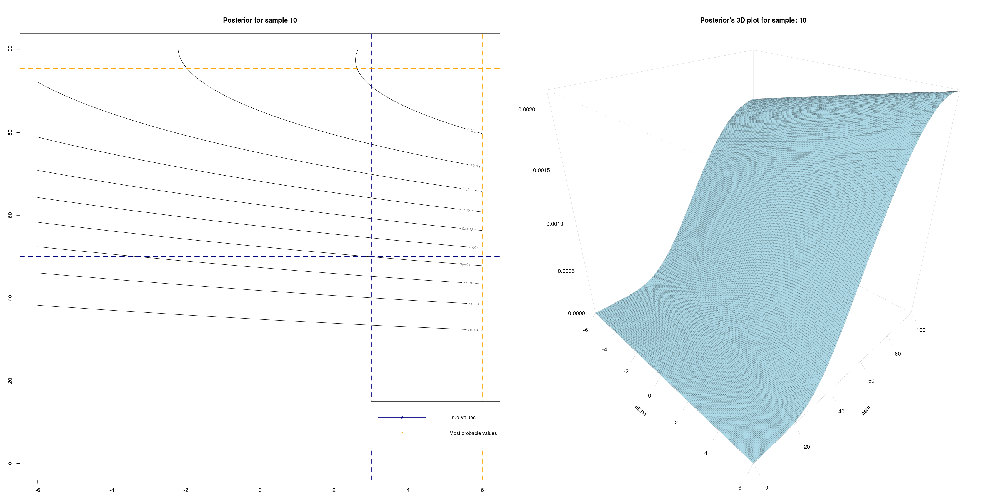

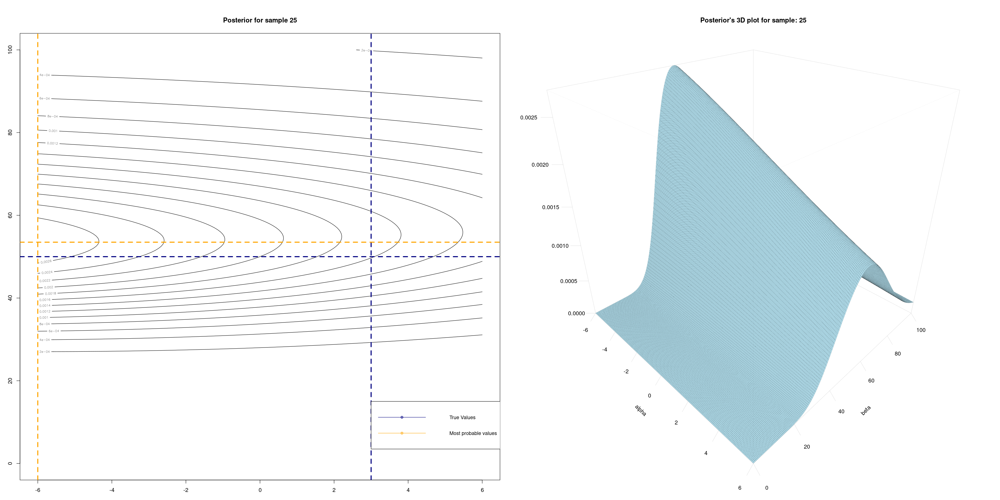

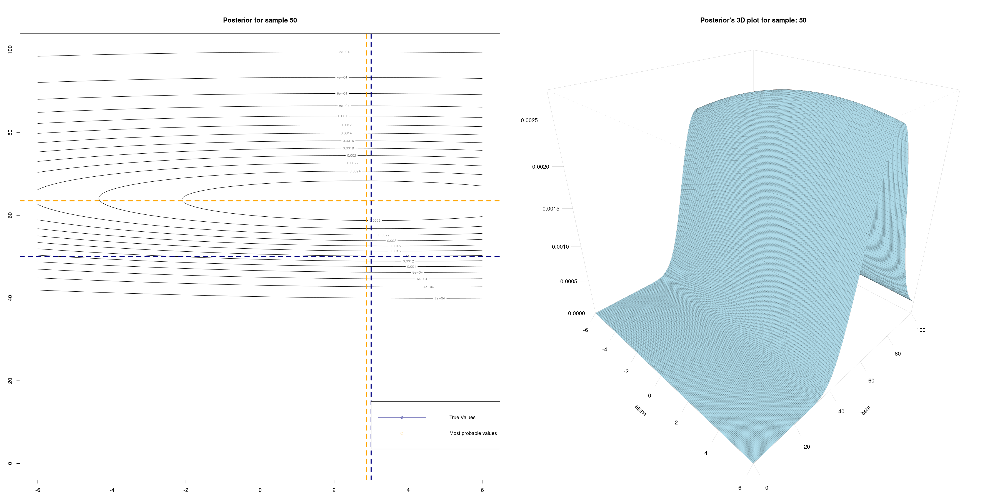

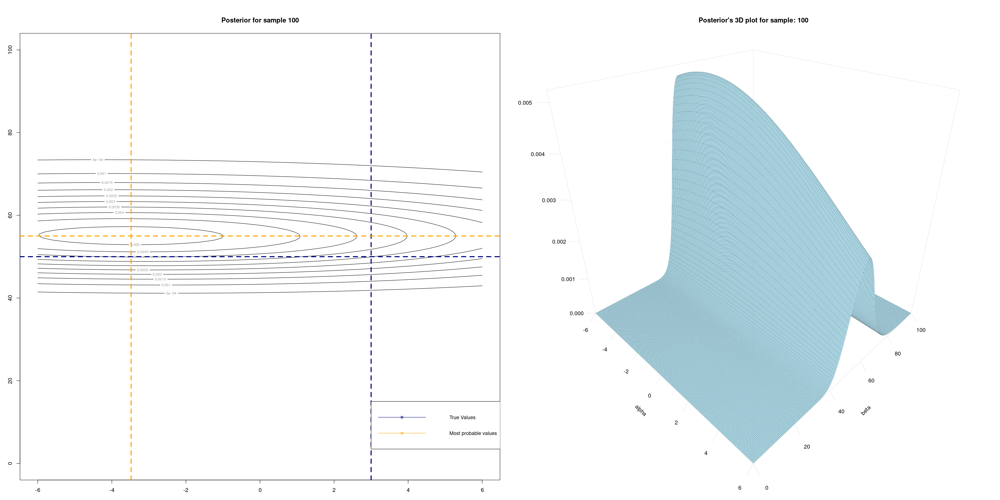

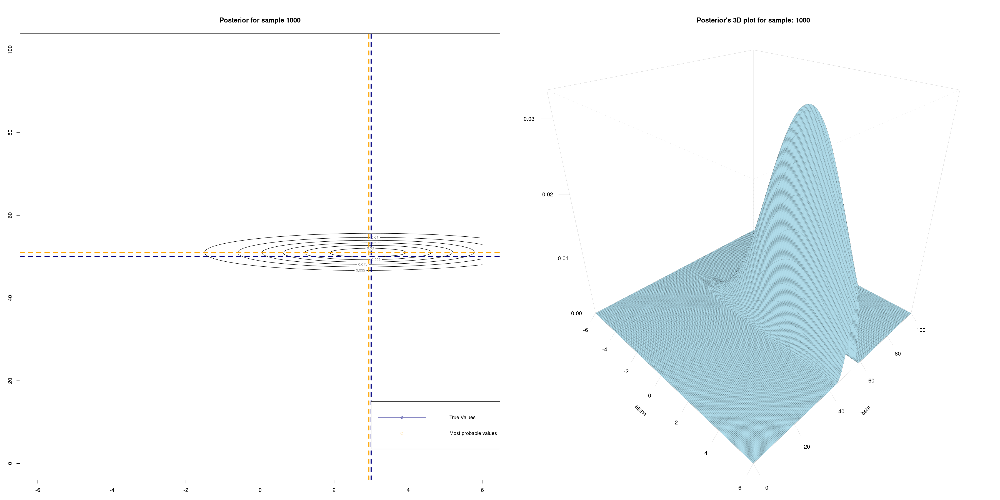

In [62]:
par(mfrow=c(1, 2), oma=c(1, 1, 1, 1), mar=c(2, 2, 4, 0))
options(repr.plot.width=30, repr.plot.height=15)

for(i in n.data){ # we want to compute posterior and plot it for all possible sample and data
    data <- x[1:i]
    a <- function(alpha,beta){
        log.post(data, alpha,beta)
    }
    post <- outer(alpha.seq, beta.seq, Vectorize(a)) # outer helps to compute log.post() and vectorize them
    

    post <- post -max(post) 
    y.post <- exp(post)/(h.x*h.y*sum(exp(post)))
    val <- matrix(y.post, nrow=length(alpha.seq), ncol=length(beta.seq))

    #want to compute most probable value for alpha and beta and point them on plot
    indx <- c(which(val==max(val), arr.ind=TRUE))
    alpha.max <- alpha.seq[indx[1]]
    beta.max <- beta.seq[indx[2]]
    # plot the countor
    contour(alpha.seq, beta.seq, val , main=paste('Posterior for sample',i),
        xlim=c(min(x.min, alpha.seq), max(x.max, alpha.seq)) , 
        ylim=c(min(0,beta.seq), max(y.max, beta.seq)),
        nlevels=10)
        #draw the true alpha and beta
        abline(v=alpha.true, lty=2, lwd=3,col='navy')
        abline(h=beta.true, lty=2, lwd=3, col='navy')
        #draw the most probable lines
        abline(v=alpha.max, lty=2, lwd=3, col='orange')
        abline(h=beta.max, lty=2, lwd=3, col='orange')
        legend(3,15,inset=0.5 ,legend=c("True Values",'Most probable values'), 
            col=c("navy", "orange"), lty=1:1, cex=0.9,box.lty=1, pch=10, horiz=FALSE)


    #plot the 3D 
    persp(alpha.seq , beta.seq , val, xlab='alpha', ylab='beta', zlab='',theta = 45, phi = 30 ,main = paste("Posterior's 3D plot for sample:",i ),lwd=0.1 ,col = 'lightblue',
    xlim=c(min(alpha.seq), max( alpha.seq)) , 
    ylim=c(min(beta.seq), max( beta.seq)),
    axes=T, ticktype="detailed")


}

## Exersice 4
\
a) vary the sample resolution of used to generate the data, keeping the same sampling range
- change the resolution $\omega$ = {0.1, 0.25, 1,2,3}
- check the effect on the result\
\
b) change the ratio $A/B$ used to simulate the data(keeping both positive in accordance with the prior)
- check the effect on the result

- The number of **expected photons** is $S_k$ (not generally an integer): 

$$
S_k = \Delta t \Big[ A \exp{\Big(- \frac{(x_k-x_0)^2}{2w^2}\Big)} + B \Big]
$$

- The number of **observed photons** $N$ follows the **Poisson distribution**, thus the **Likelihood** of the data is:

$$
P(\{N_j\}|A,B,M) = \prod_j \frac{S_k^{N_j} e^{-S_k}}{N_j!}
$$

- The **Posterior** is:

$$
P(A,B|\{N_j\},M) = \frac{1}{Z} \prod_j \frac{S_k^{N_j} e^{-S_k}}{N_j!}
$$

- The **log Posterior** results:

$$
L = \log P(A,B|\{N_j\},M) = const + \sum[N_j \log S_k - S_k] $$


In [63]:
#we assume x0 , w and delta_t are known
set.seed(208)
A.true <- 2 # Signal amplitude (unkown)
B.true <- 1 # Background amplitude (unkown)
dt <- 5     # Exposure time 
x0 <- 0     # Signal peak
w <- 1      # Signal width
w.res <- c(0.1 , 0.25 , 1, 2, 3) # vary the resulotion


#model generation
signal <- Vectorize(function(x, A, B, x0, w, dt){ 
    dt*(A*exp((-(x-x0)^2)/(2*w^2))+B)
})

#log posterior 
log.post <- function(x,A,B, x0,w, dt , data){
        if(A<0 || B <0) {return(-Inf)} # the effect of the prior 
                sum(dpois(data, lambda=signal(x, A, B, x0, w, dt), log=TRUE))
}

A.list <- c(NULL)  
B.list <- c(NULL)  

#sampling grid for computing posterior and normalize it which is in the next cell
a <- c(0.0 , 4.0)
b <- c(0,2)
samp <- 100
uni.grid <- seq(from=1/(2*samp), to= 1-1/(2*samp), by = 1/samp)
delta.a <- diff(a)/samp
delta.b <- diff(b)/samp
A <- a[1] + diff(a)*uni.grid
B <- b[1] + diff(a)*uni.grid




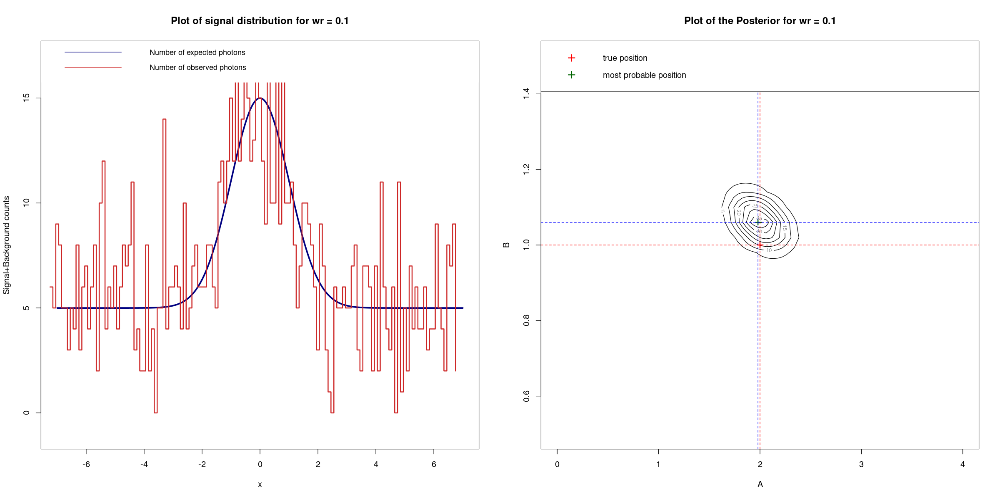

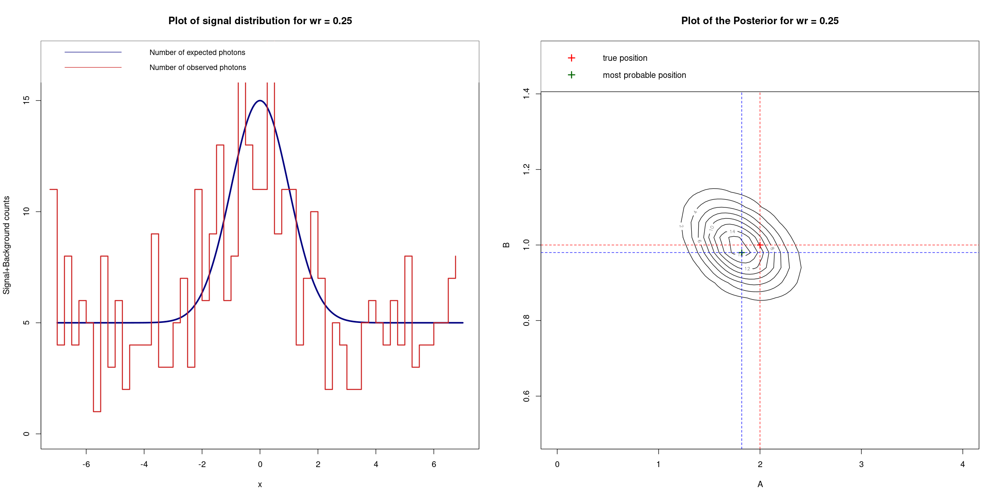

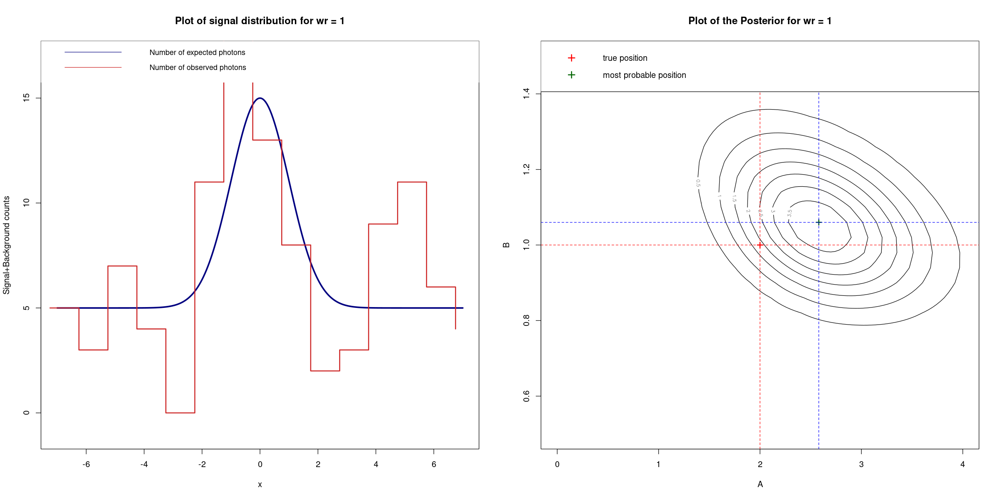

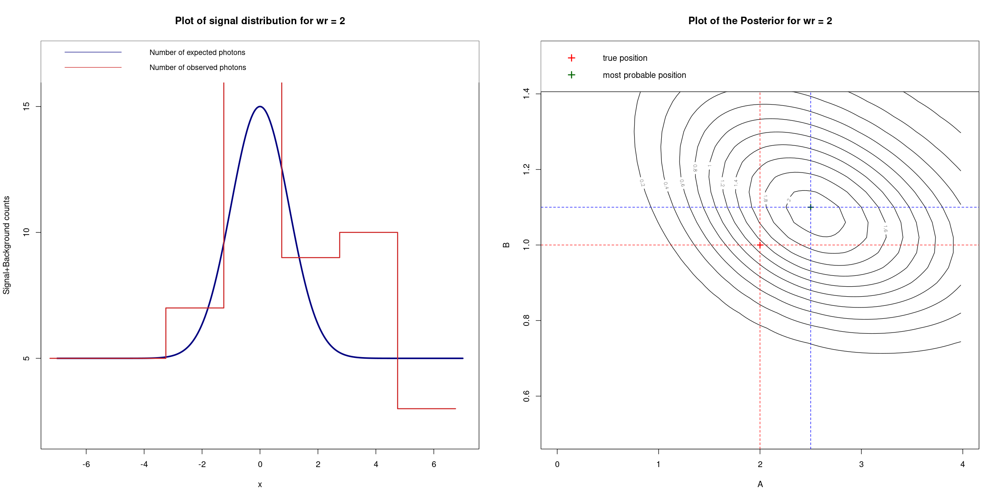

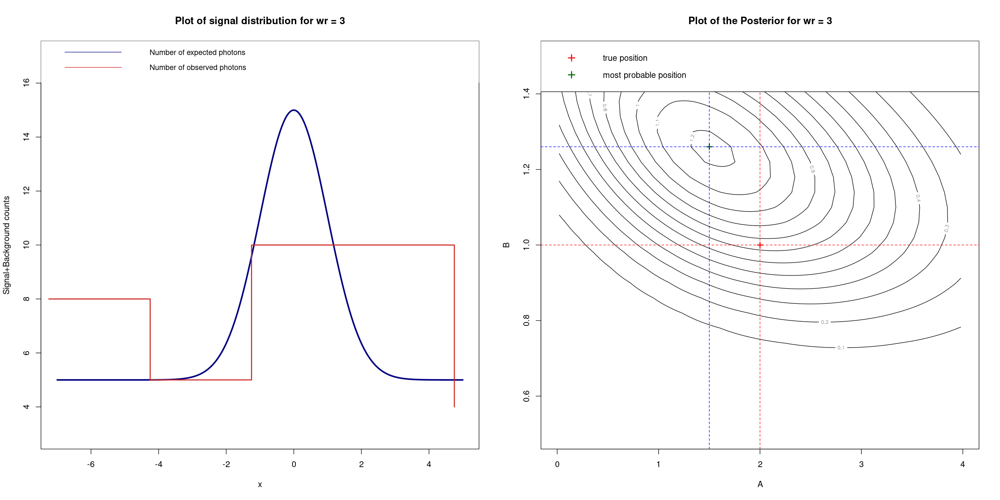

In [64]:
par(mfrow=c(1,2))
options(repr.plot.width=20, repr.plot.height=10)

set.seed(208)
for(i in w.res){
    xdat <- seq(from=-7*w , to=7*w , by=i*w) 
    s.true <- signal(xdat , A.true ,B.true , x0, w, dt)

    dat <- rpois(length(s.true), s.true)

    x.plot <- seq(from=min(xdat), to=max(xdat), by =0.05*w)
    s.plot <- signal(x.plot , A.true ,B.true , x0, w, dt)

    #plot for number of expectation
    plot(x.plot, s.plot, xlab="x", ylab="Signal+Background counts",
         type='l',lty=1, lwd=3, col='navy', ylim=c(min(dat)-1,max(s.plot)+2),
         main=paste("Plot of signal distribution for wr =",i))

    xdat.off <- xdat - 0.25 # Remove offset of the bin width
    lines(xdat.off, dat, type='s',col='firebrick3', lwd=2)
    legend("topleft",inset=-0.01,c("Number of expected photons","Number of observed photons"), 
           col=c("navy","firebrick3"), lty=1, cex=0.9,box.lty=0) 


    #calculate normalize of posterior
     post <- matrix(data=NA , nrow= length(A), ncol=length(B))
     for(n in 1:length(A)){
          for(m in 1:length(B)){
               post[n,m] <- log.post(xdat , A [n], B[m] , x0, w, dt, dat)
          }
     }      
     norm_post <- exp(post)/(delta.a*delta.b*sum(exp(post)))

     #plot the normalize posterior by contour
     contour(A, B, norm_post, main=paste("Plot of the Posterior for wr =",i),
            xlim=c(min(0,A.true),max(4,A.true)), ylim=c(min(0.5,B.true),max(1.5,B.true)), xlab="A", ylab="B",col="black",
            nlevels=10)
     # Plot of the true value of alpha and beta
     points(A.true, B.true, pch=3, col="red", lwd=2) 
     abline(h=B.true, lty=2,col='red')
     abline(v=A.true, lty=2,col='red')
     
     # Plot the most probable values of the Posterior
     index <- c(which(post==max(post), arr.ind=TRUE))
     max.A <- A[index[1]]
     max.B <- B[index[2]]
     #append most probable values to the empty lists
     A.list <- c(A.list,max.A)
     B.list <- c(B.list,max.B)

     points(max.A, max.B, pch=3, col="darkgreen", lwd=2) 
     abline(h=max.B, lty=2,col='blue')
     abline(v=max.A, lty=2,col='blue')  
     legend("topright",c("true position","most probable position"), 
           col=c("red","darkgreen"), pch=3, pt.cex=1.2, pt.lwd=2) 
     

     
}

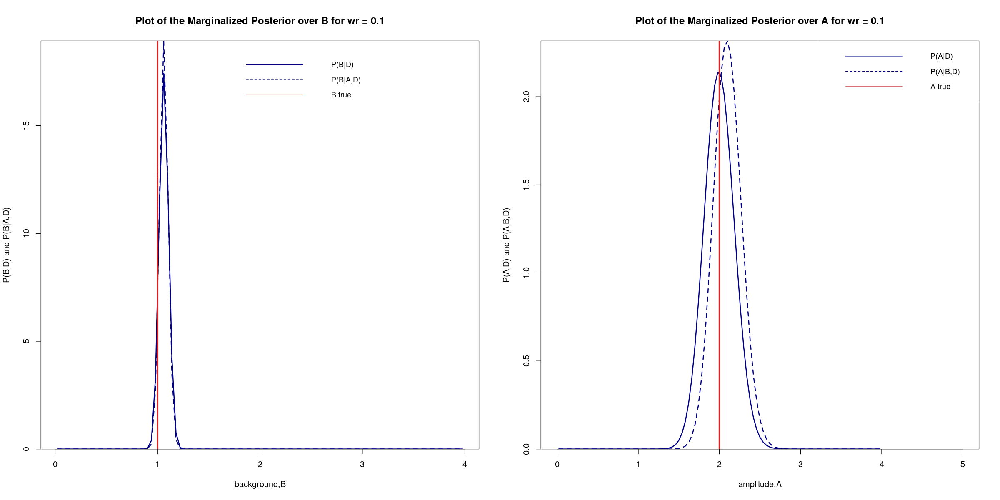

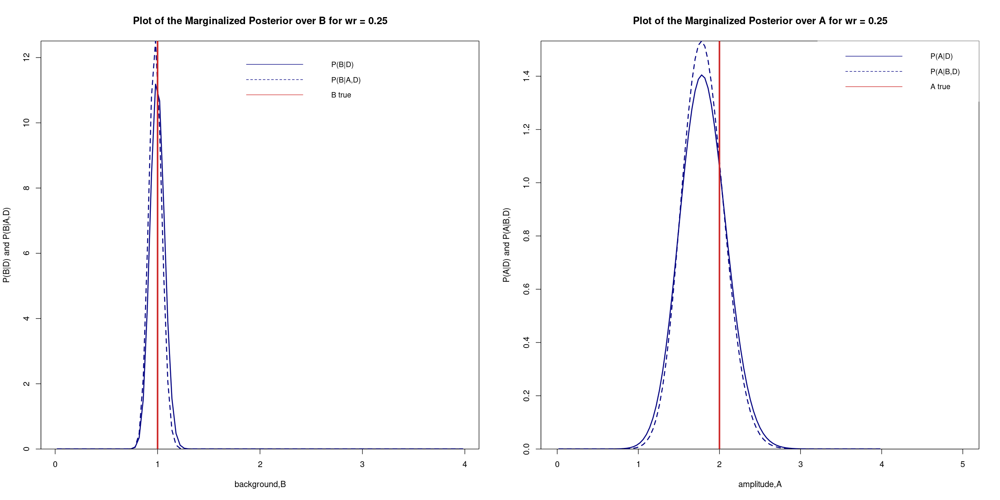

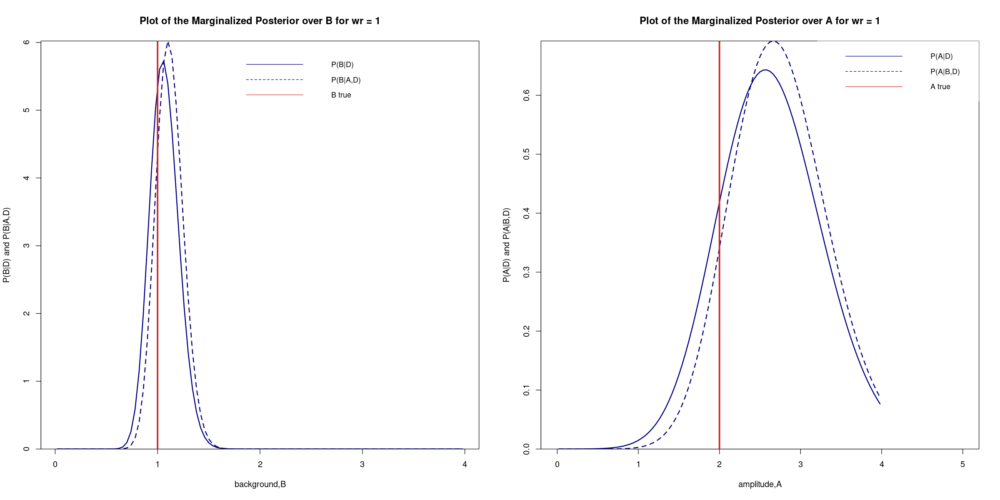

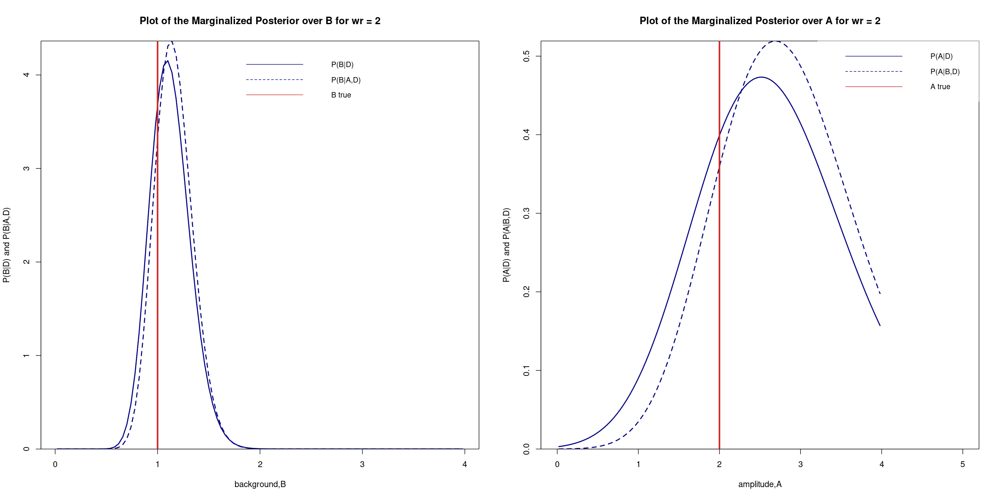

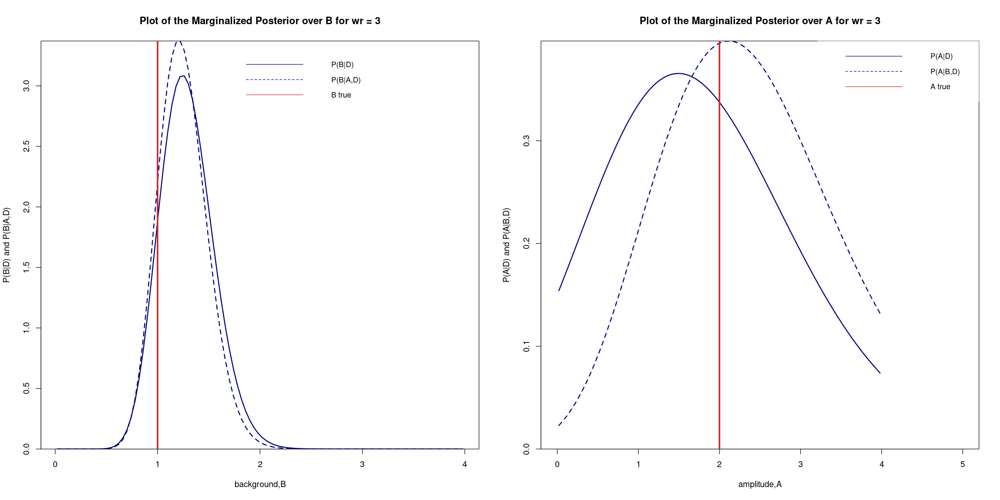

In [85]:
par(mfrow=c(1,2))
options(repr.plot.width=20, repr.plot.height=10)

set.seed(208)


for (i in w.res){

     xdat <- seq(from=-7*w , to=7*w , by=i*w) 
     s.true <- signal(xdat , A.true ,B.true , x0, w, dt)
          a <- c(0 , 4)
     b <- c(0,2)
     samp <- 100
     uni.grid <- seq(from=1/(2*samp), to= 1-1/(2*samp), by = 1/samp)
     delta.a <- diff(a)/samp
     delta.b <- diff(b)/samp
     A <- a[1] + diff(a)*uni.grid
     B <- b[1] + diff(a)*uni.grid  
    dat <- rpois(length(s.true), s.true)
    post <- matrix(data=NA , nrow= length(A), ncol=length(B))
     for(n in 1:length(A)){
          for(m in 1:length(B)){
               post[n,m] <- log.post(xdat , A [n], B[m] , x0, w, dt, dat)
          }
     }      
    

   #compute normalized marginalized posterior for a and b
   p.a <- apply(exp(post), 1, sum) # 1: because want to manipulat on rows
   p.a <- p.a/(delta.a*sum(p.a))
   p.b <- apply(exp(post),2,sum)  # 2: because want to manipulate on coloumn
   p.b <- p.b/(delta.b*sum(p.b)) 

   p.a.b <- exp(Vectorize(log.post, 'A')(xdat, A , B.true , x0, w, dt, dat))
   p.a.b <- p.a.b/(delta.a*sum(p.a.b))
   p.b.a <- exp(Vectorize(log.post, 'B')(xdat, A.true , B , x0, w, dt, dat))
   p.b.a <- p.b.a/(delta.b*sum(p.b.a))


     plot(B, p.b, xlab="background,B", yaxs="i", lty=1, col='navy',
              #xlim = c(min(p.b, p.b.a),max(p.b, p.b.a)),
              ylim=c(min(0, p.b.a),max(0, p.b.a)), 
              ylab="P(B|D) and P(B|A,D)",
           type="l", lwd=2, main=paste("Plot of the Marginalized Posterior over B for wr =",i))
          lines(B, p.b.a, lwd=2, lty=2, col='navy') 
          abline(v=B.true, col="firebrick3",lty=1,lwd=3)
          legend("topright",inset=0.02,c("P(B|D)","P(B|A,D)","B true"), 
               col=c("navy","navy","firebrick3"), lty=1:2, pt.cex=1.2, pt.lwd=2,
              cex=0.9,box.lty=0)
   
    
     #P(A|D) and P(A|B,D)
     plot(A, p.a, xlab="amplitude,A", yaxs="i", lty=1, col='navy',
           xlim = c(0,5),
           #ylim=c(0,2.5),
           ylim=c(min(0, p.a.b),max(0, p.a.b)), 
           ylab="P(A|D) and P(A|B,D)", 
           type="l", lwd=2, main=paste("Plot of the Marginalized Posterior over A for wr =",i))
      lines(A, p.a.b, lwd=2, lty=2,col='navy') 
      abline(v=A.true, col="firebrick3",lty=1,lwd=3)
      
      legend("topright",inset=c(-0.2,0) , legend=c("P(A|D)","P(A|B,D)","A true"),
           col=c("navy","navy","firebrick3"), lty=1:2, pt.cex=1.2, pt.lwd=2,
           cex=0.9,box.lty=0)
   #grid()
}

### b)

In [103]:

#vary the ratio A/B
ratio <- c(seq(from=0.6, to=6, length.out=5)) #put some random ratio
#ratio
#model generation
signal <- Vectorize(function(x, A, B, x0, w, dt){ 
    dt*(A*exp((-(x-x0)^2)/(2*w^2))+B)
})

#log posterior 
log.post <- function(x,A,B, x0,w, dt , data){
        if(A<0 || B <0) {return(-Inf)} # the effect of the prior 
                sum(dpois(data, lambda=signal(x, A, B, x0, w, dt), log=TRUE))
}

A.list <- c(NULL)  
A.true.list <- c(NULL)
B.list <- c(NULL) 
B.true.list <- c(NULL)


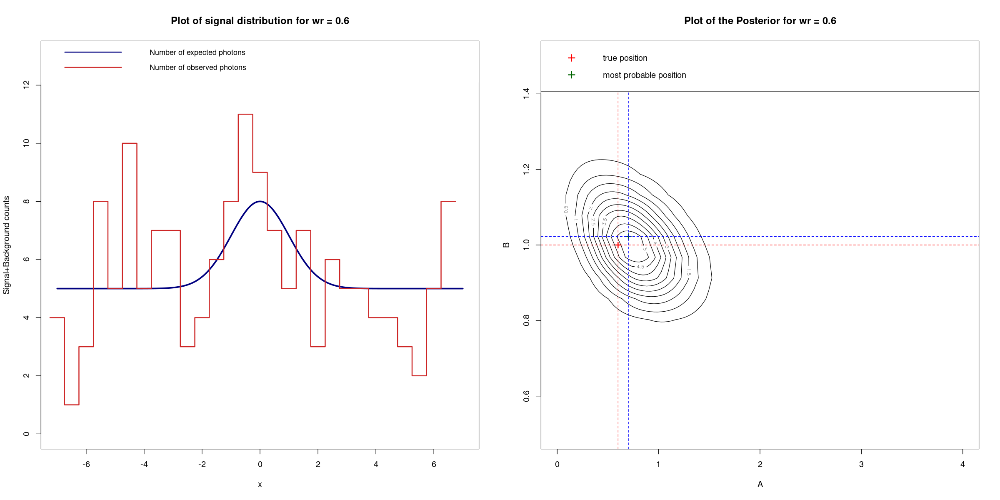

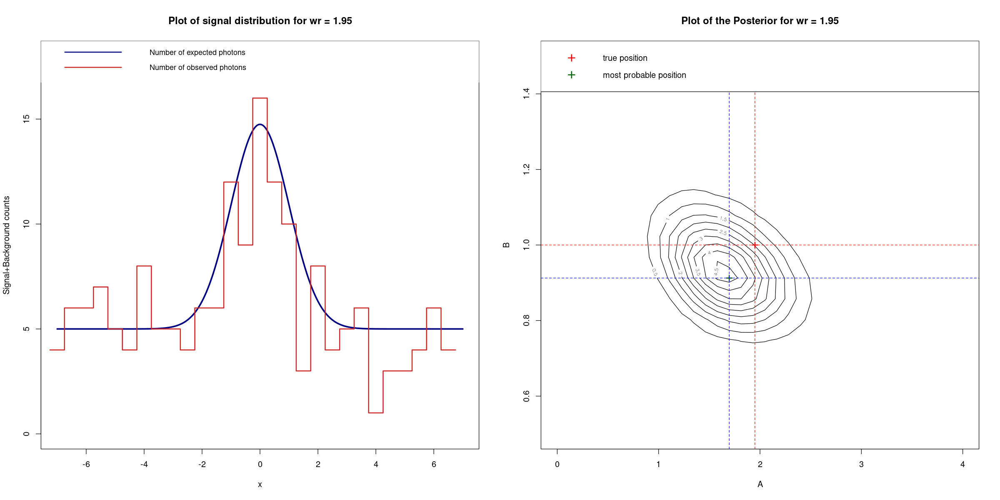

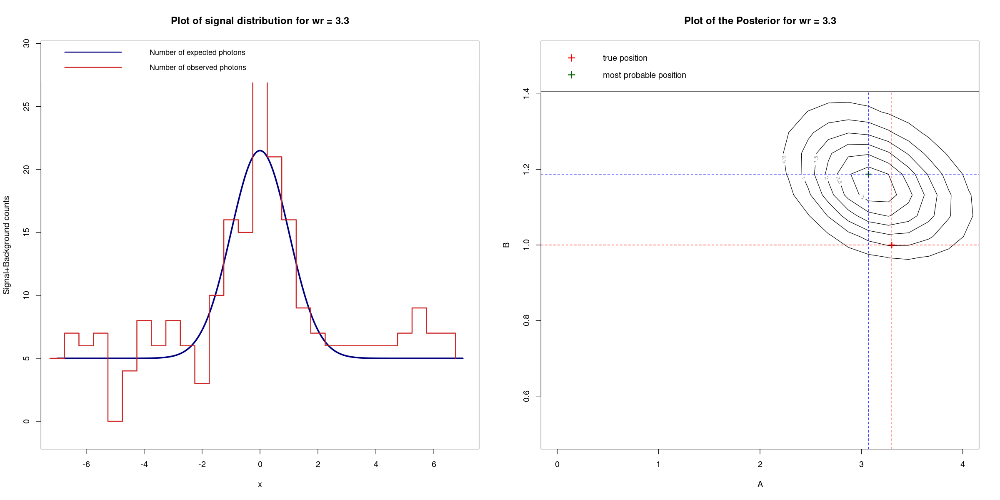

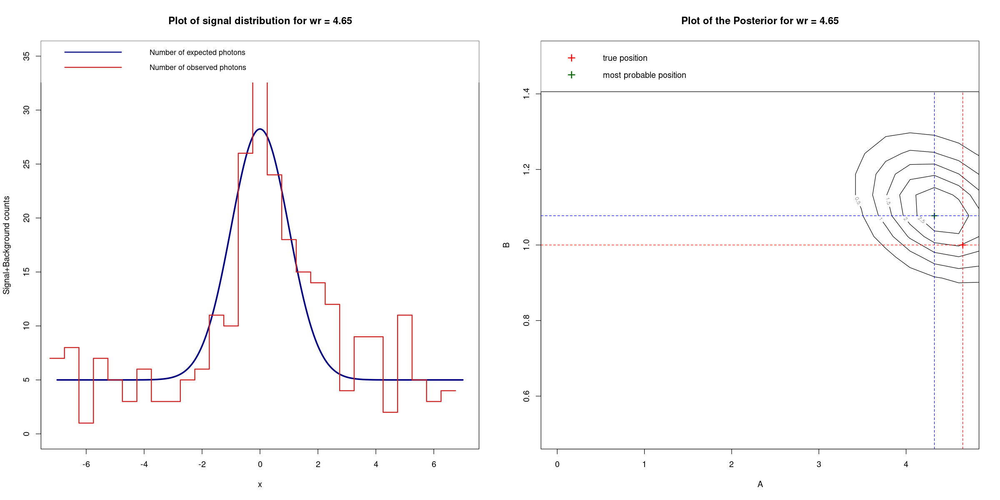

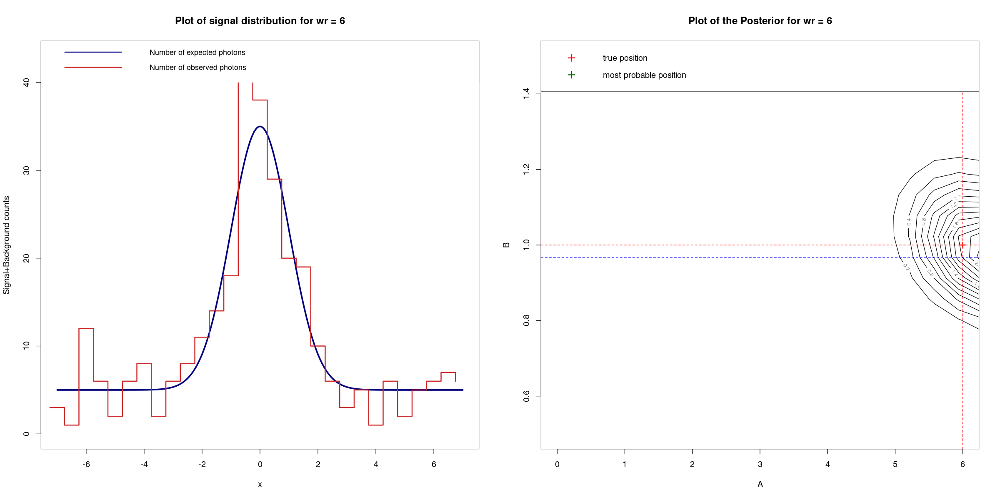

In [104]:
par(mfrow=c(1,2))
options(repr.plot.width=20, repr.plot.height=10)
set.seed(6666)



for(i in ratio){
     #put the value another time
     B.true <- 1
     A.true <- i*B.true
     dt <- 5
     x0 <- 0
     w <- 1

    xdat <- seq(from=-7*w , to=7*w , by=0.5*w) 
    s.true <- signal(xdat , A.true ,B.true , x0, w, dt)

    dat <- rpois(length(s.true), s.true)

    x.plot <- seq(from=min(xdat), to=max(xdat), by =0.05*w)
    s.plot <- signal(x.plot , A.true ,B.true , x0, w, dt)


    #plot for number of expectation
    plot(x.plot, s.plot, xlab="x", ylab="Signal+Background counts",
         type='l',lty=1, lwd=3, col='navy', ylim=c(min(dat)-1,max(dat)+2),
         main=paste("Plot of signal distribution for wr =",i))

      xdat.off <- xdat - 0.25 # Remove offset of the bin width
      lines(xdat.off, dat, type='s',col='firebrick3', lwd=2)
      legend("topleft",inset=-0.01,c("Number of expected photons","Number of observed photons"), 
           col=c("navy","firebrick3"), lty=1,lwd=2,  cex=0.9,box.lty=0) 


     a <- c(0.0 , A.true+5*A.true)
     b <- c(0.5, B.true +5*B.true)
     sam <- 100
     uni.grid <- seq(from=1/(2*sam), to=1-1/(2*sam), by=1/sam)
     delta.a <- diff(a)/sam
     delta.b <- diff(b)/sam
     A <- a[1] +diff(a)*uni.grid
     B <- b[1] +diff(b)*uni.grid

    #calculate normalize of posterior
     post <- matrix(data=NA , nrow= length(A), ncol=length(B))
     for(n in 1:length(A)){
          for(m in 1:length(B)){
               post[n,m] <- log.post(xdat , A [n], B[m] , x0, w, dt, dat)
          }
     }      
     norm_post <- exp(post)/(delta.a*delta.b*sum(exp(post)))

     #plot the normalize posterior by contour
     contour(A, B, norm_post, main=paste("Plot of the Posterior for wr =",i),
            xlim=c(min(0,A.true),max(4,A.true)), ylim=c(min(0.5,B.true),max(1.5,B.true)), xlab="A", ylab="B",col="black",
            nlevels=10)
     # Plot of the true value of alpha and beta
     points(A.true, B.true, pch=3, col="red", lwd=2) 
     abline(h=B.true, lty=2,col='red')
     abline(v=A.true, lty=2,col='red')
     
     # Plot the most probable values of the Posterior
     index <- c(which(post==max(post), arr.ind=TRUE))
     max.A <- A[index[1]]
     max.B <- B[index[2]]
     #append most probable values to the empty lists
     A.list <- c(A.list,max.A)
     B.list <- c(B.list,max.B)
     A.true.list <- c(A.true.list,A.true)
     B.true.list <- c(B.true.list,B.true)

     points(max.A, max.B, pch=3, col="darkgreen", lwd=2) 
     abline(h=max.B, lty=2,col='blue')
     abline(v=max.A, lty=2,col='blue')  
     legend("topright",c("true position","most probable position"), 
           col=c("red","darkgreen"), pch=3, pt.cex=1.2, pt.lwd=2) 
}

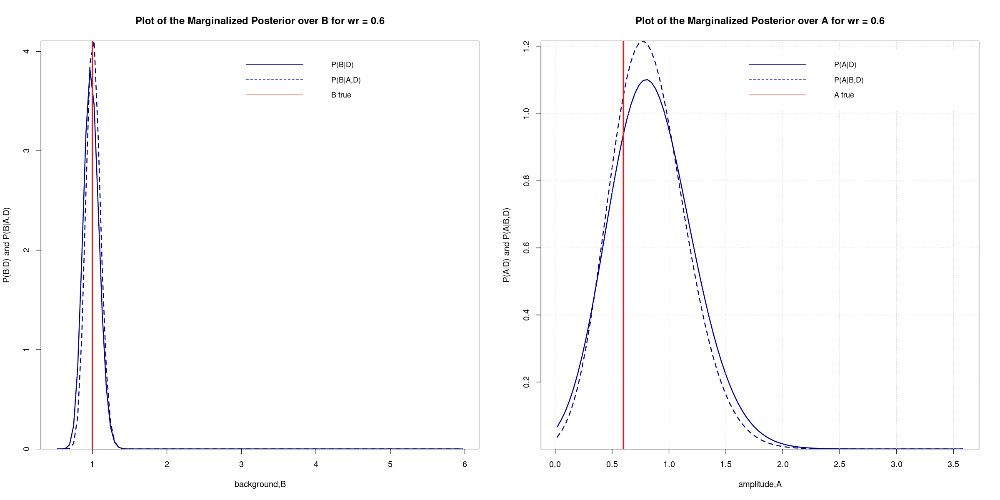

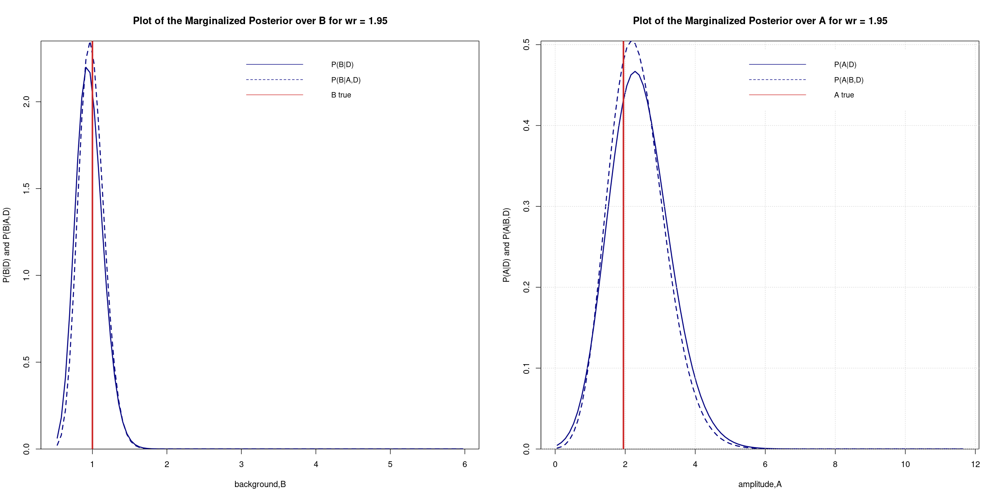

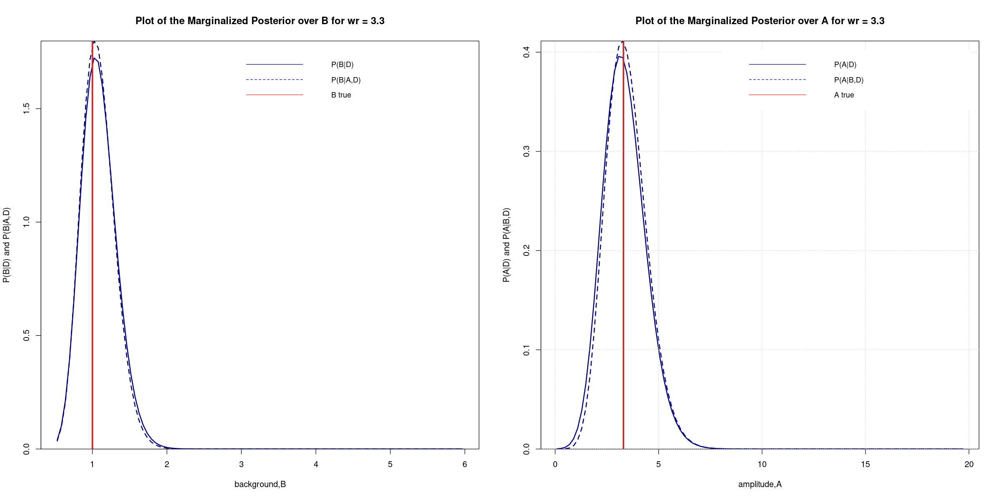

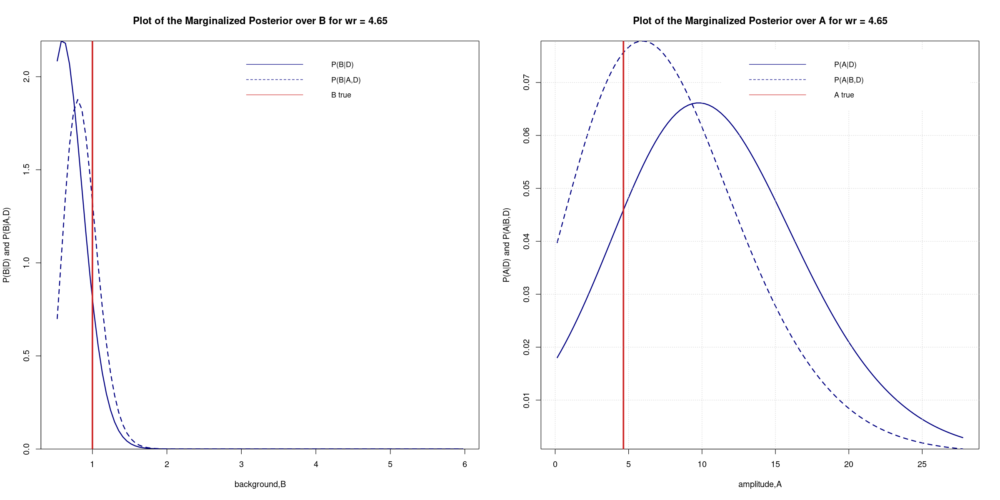

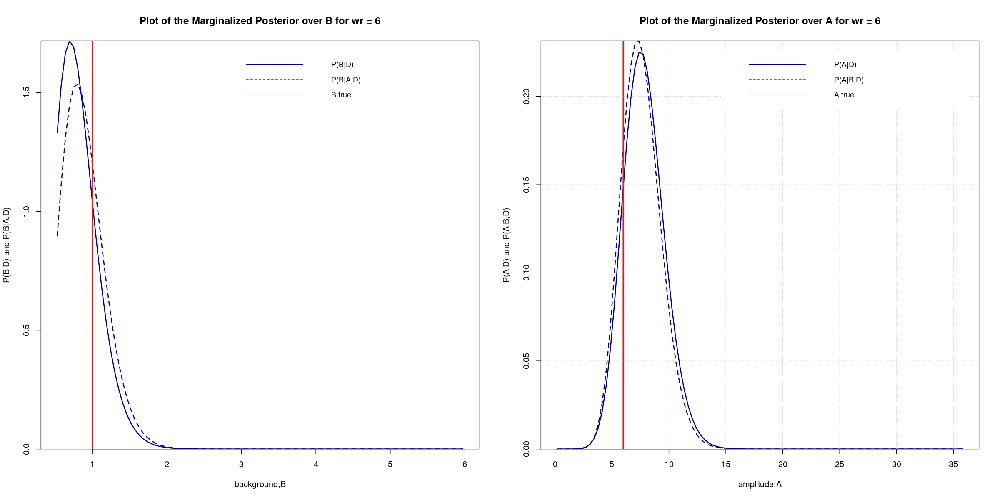

In [105]:
par(mfrow=c(1,2))
options(repr.plot.width=20, repr.plot.height=10)

set.seed(6666)


for (i in ratio){
     #put the value another time
     B.true <- 1
     A.true <- i*B.true
     dt <- 5
     x0 <- 0
     w <- 1
     a <- c(0.0 , A.true+5*A.true)
     b <- c(0.5, B.true +5*B.true)
     sam <- 100
     uni.grid <- seq(from=1/(2*sam), to=1-1/(2*sam), by=1/sam)
     delta.a <- diff(a)/sam
     delta.b <- diff(b)/sam
     A <- a[1] +diff(a)*uni.grid
     B <- b[1] +diff(b)*uni.grid


     xdat <- seq(from=-7*w , to=7*w , by=i*w) 
     s.true <- signal(xdat , A.true ,B.true , x0, w, dt)

    dat <- rpois(length(s.true), s.true)
    post <- matrix(data=NA , nrow= length(A), ncol=length(B))
     for(n in 1:length(A)){
          for(m in 1:length(B)){
               post[n,m] <- log.post(xdat , A [n], B[m] , x0, w, dt, dat)
          }
     }      
    

   #compute normalized marginalized posterior for a and b
   p.a <- apply(exp(post), 1, sum) # 1: because want to manipulat on rows
   p.a <- p.a/(delta.a*sum(p.a))
   p.b <- apply(exp(post),2,sum)  # 2: because want to manipulate on coloumn
   p.b <- p.b/(delta.b*sum(p.b)) 

   p.a.b <- exp(Vectorize(log.post, 'A')(xdat, A , B.true , x0, w, dt, dat))
   p.a.b <- p.a.b/(delta.a*sum(p.a.b))
   p.b.a <- exp(Vectorize(log.post, 'B')(xdat, A.true , B , x0, w, dt, dat))
   p.b.a <- p.b.a/(delta.b*sum(p.b.a))

    plot(B, p.b, xlab="background,B", yaxs="i", lty=1, col='navy',
         #xlim = c(min(p.b, p.b.a),max(p.b, p.b.a)), 
         ylim=c(min(p.b, p.b.a),max(p.b, p.b.a)), ylab="P(B|D) and P(B|A,D)",
         type="l", lwd=2, main=paste("Plot of the Marginalized Posterior over B for wr =",i))
     lines(B, p.b.a, lwd=2, lty=2, col='navy') 
     abline(v=B.true, col="firebrick3",lty=1,lwd=3)
     legend("topright",inset=0.02,c("P(B|D)","P(B|A,D)","B true"), 
           col=c("navy","navy","firebrick3"), lty=1:2, pt.cex=1.2, pt.lwd=2,
           cex=0.9,box.lty=0)
   
    
    # P(A|D) and P(A|B,D)
    plot(A, p.a, xlab="amplitude,A", yaxs="i", lty=1, col='navy',
         #xlim= c(min(p.a, p.a.b, A),max(p.a, p.a.b, A)), 
         ylim=c(min(p.a, p.a.b),max(p.a, p.a.b)), ylab="P(A|D) and P(A|B,D)", 
         type="l", lwd=2, main=paste("Plot of the Marginalized Posterior over A for wr =",i))
    lines(A, p.a.b, lwd=2, lty=2,col='navy') 
    abline(v=A.true, col="firebrick3",lty=1,lwd=3)
    grid()
    legend("topright",inset=0.02,c("P(A|D)","P(A|B,D)","A true"), 
           col=c("navy","navy","firebrick3"), lty=1:2, pt.cex=1.2, pt.lwd=2,
           cex=0.9,box.lty=0)
  
}

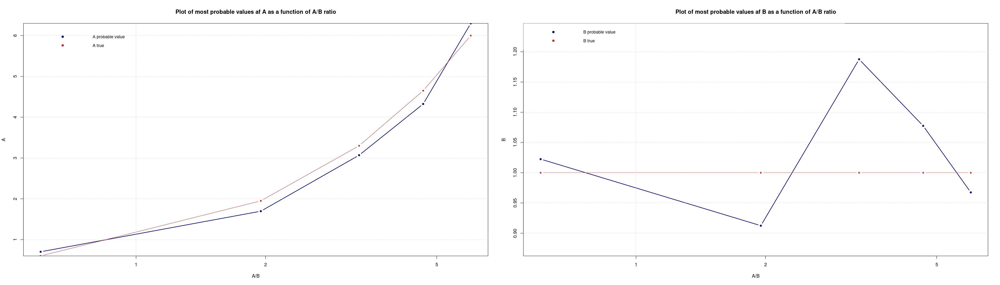

In [144]:
# Compare the most probable values of A and B for different A/B ratios

# set the size and position of the plots
par(mfrow=c(1,2))
options(repr.plot.width=35, repr.plot.height=10)


plot(ratio, A.list, xlab="A/B", yaxs="i", pch=20, col='navy',
     ylim=c(min(A.list,A.true.list),max(A.list,A.true.list)), ylab="A", 
     type="b", lwd=2, main="Plot of most probable values af A as a function of A/B ratio",
     log='x')
lines(ratio,A.true.list,type="b",pch=20,col="firebrick3")
legend("topleft",inset=0.02,c("A probable value","A true"), 
           col=c("navy","firebrick3"), pch=c(20,20), pt.cex=1.2, pt.lwd=2,
           cex=0.9,box.lty=0)


grid()

plot(ratio, B.list, xlab="A/B", yaxs="i", pch=20, col='navy',
     ylim=c(min(B.list,B.true.list)-0.05,max(B.list,B.true.list)*1.05),
      ylab="B", 
     type="b", lwd=2, main="Plot of most probable values af B as a function of A/B ratio",
     log='x') 
lines(ratio,B.true.list,type="b",pch=20,col="firebrick3")

legend("topleft",c("B probable value","B true"), 
           col=c("navy","firebrick3"), pch=c(20,20),pt.cex=1.2, pt.lwd=2,
           cex=0.9,box.lty=0)
grid()

